In [1]:
%load_ext autoreload
%autoreload 2
import pathlib
import sys
path_to_lib = pathlib.Path('./').resolve().parent
if str(path_to_lib) not in sys.path:
    sys.path.insert(0, str(path_to_lib))
import turbohack
from turbohack import plot_confusion_matrix
import pandas as pd
import pathlib
import plotly
import plotly.graph_objects as go
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
from fbprophet import Prophet
import re
import pdb
from tqdm.notebook import tqdm

In [2]:
path_to_data_dir = pathlib.Path("/mnt/c/Users/anton/programming/turbohack/data/task1")

In [3]:
train_markup = pd.read_excel(path_to_data_dir / 'train_markup.xlsx')
train_nomarkup = pd.read_excel(path_to_data_dir / 'train_nomarkup.xlsx')
test_markup = pd.read_excel(path_to_data_dir / 'test_markup.xlsx')
test_nomarkup = pd.read_excel(path_to_data_dir / 'test_nomarkup.xlsx')

In [4]:
all_names_dict = dict()
for col in list(train_markup.columns) + list(train_nomarkup.columns) + list(test_markup.columns) + list(test_nomarkup.columns):
    if col in all_names_dict.keys():
        continue
    all_names_dict[col] = f'f{len(all_names_dict)}'
all_names_dict['Параметр'] = 'date_col'

In [5]:
train_markup = train_markup.rename(columns=all_names_dict)
train_nomarkup = train_nomarkup.rename(columns=all_names_dict)
test_markup = test_markup.rename(columns=all_names_dict)
test_nomarkup = test_nomarkup.rename(columns=all_names_dict)

In [6]:
train_nomarkup.shape

(37339, 45)

In [7]:
train_markup.shape

(36816, 45)

In [8]:
train_nomarkup.head(3)

,date_col,f1,f2,f3,f4,f5,f6,f7,f8,f9,...,f35,f36,f37,f38,f39,f40,f41,f42,f43,f44
0,2021-03-24 13:30:00,554.01,546.45,568.66,553.95,550.21,549.53,564.10,564.59,555.75,...,545.17,534.33,531.89,533.32,564.66,554.75,539.90,537.91,562.42,566.70
1,2021-03-24 13:40:00,566.22,557.23,583.57,567.53,564.84,560.93,580.80,580.53,570.74,...,566.10,549.94,547.08,547.60,578.51,572.07,553.96,550.94,571.90,578.61
2,2021-03-24 13:50:00,577.64,566.55,590.45,576.19,573.11,571.31,590.91,589.67,579.19,...,577.83,560.46,556.89,555.97,585.74,581.30,561.09,560.34,577.21,577.46


In [9]:
roll_val_m = train_markup.loc[:, 'f43'].rolling(window=5).mean().fillna(0)
roll_val_nm = train_nomarkup.loc[:, 'f43'].rolling(window=5).mean().fillna(0)

fig = go.Figure()
fig.add_trace(
    go.Scatter(
        x=train_markup.loc[:, 'date_col'],
        y=train_markup.loc[:, 'f43'] - roll_val_m,
        name='markup'
    )
)
fig.add_trace(
    go.Scatter(
        x=train_nomarkup.loc[:, 'date_col'],
        y=train_nomarkup.loc[:, 'f43'] - roll_val_nm,
        name='nomarkup'
    )
)

In [10]:
train_dataset = train_nomarkup.copy()
target = (~train_nomarkup['f31'].isin(train_markup['f31'])).astype(int)
train_dataset.loc[:, 'target'] = target
test_dataset = test_nomarkup.copy()
target = (~test_nomarkup['f31'].isin(test_markup['f31'])).astype(int)
test_dataset.loc[:, 'target'] = target

In [11]:
train_dataset.head(3)

,date_col,f1,f2,f3,f4,f5,f6,f7,f8,f9,...,f36,f37,f38,f39,f40,f41,f42,f43,f44,target
0,2021-03-24 13:30:00,554.01,546.45,568.66,553.95,550.21,549.53,564.10,564.59,555.75,...,534.33,531.89,533.32,564.66,554.75,539.90,537.91,562.42,566.70,1
1,2021-03-24 13:40:00,566.22,557.23,583.57,567.53,564.84,560.93,580.80,580.53,570.74,...,549.94,547.08,547.60,578.51,572.07,553.96,550.94,571.90,578.61,0
2,2021-03-24 13:50:00,577.64,566.55,590.45,576.19,573.11,571.31,590.91,589.67,579.19,...,560.46,556.89,555.97,585.74,581.30,561.09,560.34,577.21,577.46,0


In [23]:
%%time
feature_cols = [col for col in train_dataset.columns if re.match(r'^f\d+$', col)]
prophet_cleaner = turbohack.ProphetCleaner(
    daily_seasonality=False,
    yearly_seasonality=False,
    weekly_seasonality=False,
    seasonality_mode='additive',
    interval_width=0.99,
    changepoint_range=0.8
)
prophet_cleaner.fit(train_dataset, feature_cols[:2], 'date_col')
#res_train, res_test = fit_predict_prophet(train_dataset, test_dataset, 'date_col', feature_cols)

  0%|          | 0/2 [00:00<?, ?it/s]

INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


CPU times: user 44.5 s, sys: 282 ms, total: 44.8 s
Wall time: 44.2 s


In [26]:
%%time
res_train = prophet_cleaner.predict(train_dataset)

  0%|          | 0/46 [00:00<?, ?it/s]

CPU times: user 1min 6s, sys: 2min 1s, total: 3min 7s
Wall time: 37 s


Text(33.0, 0.5, 'target')

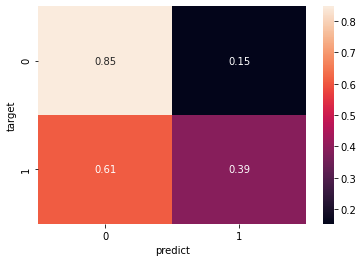

In [33]:
anomaly_cols = [col for col in res_train.columns if re.match(r'^anomaly_f\d+$', col)]
#anomaly_cols = ['anomaly_f29']
res = res_train[anomaly_cols + ['target']].copy()
res.loc[:, anomaly_cols] = res[anomaly_cols].replace({-1: 1})
res.loc[:, ['predict']] = res[anomaly_cols].max(axis=1)

sns.heatmap(confusion_matrix(res['target'], res['predict'], normalize='true'), annot=True)
plt.xlabel('predict')
plt.ylabel('target')

In [35]:
prophet_cleaner.forecast['f1']

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,daily,...,daily_upper,weekly,weekly_lower,weekly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat,fact,anomaly
0,2021-03-24 13:30:00,561.181864,557.205022,566.551056,561.181864,561.181864,0.802460,0.802460,0.802460,0.916495,...,0.916495,-0.114035,-0.114035,-0.114035,0.0,0.0,0.0,561.984325,554.01,-1
1,2021-03-24 13:40:00,561.184903,557.413317,566.660362,561.184903,561.184903,0.824964,0.824964,0.824964,0.938166,...,0.938166,-0.113202,-0.113202,-0.113202,0.0,0.0,0.0,562.009867,566.22,0
2,2021-03-24 13:50:00,561.187941,557.360962,566.399161,561.187941,561.187941,0.843357,0.843357,0.843357,0.955784,...,0.955784,-0.112427,-0.112427,-0.112427,0.0,0.0,0.0,562.031298,577.64,1
3,2021-03-24 14:00:00,561.190979,557.634830,566.372772,561.190979,561.190979,0.858207,0.858207,0.858207,0.969918,...,0.969918,-0.111711,-0.111711,-0.111711,0.0,0.0,0.0,562.049187,586.00,1
4,2021-03-24 14:10:00,561.194018,557.877634,566.691806,561.194018,561.194018,0.870103,0.870103,0.870103,0.981158,...,0.981158,-0.111054,-0.111054,-0.111054,0.0,0.0,0.0,562.064121,588.59,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37334,2022-03-22 04:20:00,557.203960,551.927251,560.697178,557.203960,557.203960,-0.799108,-0.799108,-0.799108,-0.738382,...,-0.738382,-0.060726,-0.060726,-0.060726,0.0,0.0,0.0,556.404852,555.43,0
37335,2022-03-22 04:30:00,557.203888,551.716850,561.222440,557.203888,557.203888,-0.773313,-0.773313,-0.773313,-0.706697,...,-0.706697,-0.066616,-0.066616,-0.066616,0.0,0.0,0.0,556.430575,555.73,0
37336,2022-03-22 04:40:00,557.203816,552.267891,561.177036,557.203816,557.203816,-0.748171,-0.748171,-0.748171,-0.675706,...,-0.675706,-0.072465,-0.072465,-0.072465,0.0,0.0,0.0,556.455645,556.68,0
37337,2022-03-22 04:50:00,557.203744,551.982506,560.955521,557.203744,557.203744,-0.724538,-0.724538,-0.724538,-0.646265,...,-0.646265,-0.078273,-0.078273,-0.078273,0.0,0.0,0.0,556.479206,557.01,0


In [50]:
import numpy as np
import pandas as pd
import datetime

def get_changepoint_idx(length, n_changepoints, changepoint_range = 0.8): # 0.8 is the Prophet default – do not create changepoints in the last 20% of the data
    historical_size = int(np.floor(length * changepoint_range)) # length of relevant area
    return np.linspace(0, historical_size -1, n_changepoints+1).round().astype(int)[1:]

def make_changepoint_features(n, changes_idx):
    linear = np.arange(n).reshape(-1,1)
    features = [linear]
    for i in changes_idx:
        slope_features = np.zeros(n)
        slope_features[i:] = np.arange(0, n-i)
        slope_features = slope_features.reshape(-1,1)
        features.append(slope_features)
    features = np.concatenate(features, axis=1)
    return features

# create a random series to test on
#d = (np.random.rand(len(d))-0.45).cumsum()
#ds = pd.DataFrame([pd.date_range(datetime.datetime(2020, 1, 1), freq='w', periods=len(d)), d], index=['ds', 'y']).T

# run Prophet
changepoint_prior_scale = 0.3
m = Prophet(daily_seasonality = False, yearly_seasonality = False, weekly_seasonality = False,
               seasonality_mode = 'additive', interval_width = 0.99, changepoint_range = 0.8)
tt_data = train_dataset.copy()
tt_data = tt_data.rename(columns={'date_col': 'ds', 'f31': 'y'})
m.fit(tt_data)
forecast = m.predict(tt_data)

# extract the learned parameters from the model
initial_slope = m.params['k'][0]
intercept = m.params['m'][0]
deltas_coefs = m.params['delta'][0]
features_coefs = np.concatenate([initial_slope, deltas_coefs])

scale = tt_data.y.max() # Prophet scales the data by dividing by the max value before prediction, we will multiple by it to get to the original scale
idx = get_changepoint_idx(len(tt_data), 25)
comb_features = make_changepoint_features(len(tt_data), idx)/len(tt_data)

#ds.y.plot()
#forecast.yhat.plot(label='Prophet prediction')
tt_preds = pd.Series(((comb_features * features_coefs).sum(axis=1) +intercept) * scale)
#plt.legend(fontsize=14)

In [51]:
fig = go.Figure()
fig.add_trace(
    go.Scatter(
        x=train_nomarkup.loc[:, 'date_col'],
        y=tt_preds,
        name='yhat'
    )
)
fig.add_trace(
    go.Scatter(
        x=train_nomarkup.loc[:, 'date_col'],
        y=forecast.yhat,
        name='prophet'
    )
)
fig.add_trace(
    go.Scatter(
        x=train_nomarkup.loc[:, 'date_col'],
        y=train_nomarkup.loc[:, 'f31'],
        name='nomarkup'
    )
)
fig.add_trace(
    go.Scatter(
        x=train_markup.loc[:, 'date_col'],
        y=train_markup.loc[:, 'f31'],
        name='markup'
    )
)

## fastpredict Prophet

In [17]:
import numpy as np
import pandas as pd

#from prophet import Prophet


def _make_historical_mat_time(deltas, changepoints_t, t_time, n_row=1):
    """
    Creates a matrix of slope-deltas where these changes occured in training data according to the trained prophet obj
    """
    diff = np.diff(t_time).mean()
    prev_time = np.arange(0, 1 + diff, diff)
    idxs = []
    for changepoint in changepoints_t:
        idxs.append(np.where(prev_time > changepoint)[0][0])
    prev_deltas = np.zeros(len(prev_time))
    prev_deltas[idxs] = deltas
    prev_deltas = np.repeat(prev_deltas.reshape(1, -1), n_row, axis=0)
    return prev_deltas, prev_time


def prophet_logistic_uncertainty(
    mat: np.ndarray,
    deltas: np.ndarray,
    prophet_obj: Prophet,
    cap_scaled: np.ndarray,
    t_time: np.ndarray,
):
    """
    Vectorizes prophet's logistic growth uncertainty by creating a matrix of future possible trends.
    """

    def ffill(arr):
        mask = arr == 0
        idx = np.where(~mask, np.arange(mask.shape[1]), 0)
        np.maximum.accumulate(idx, axis=1, out=idx)
        return arr[np.arange(idx.shape[0])[:, None], idx]

    k = prophet_obj.params["k"][0]
    m = prophet_obj.params["m"][0]
    n_length = len(t_time)
    #  for logistic growth we need to evaluate the trend all the way from the start of the train item
    historical_mat, historical_time = _make_historical_mat_time(deltas, prophet_obj.changepoints_t, t_time, len(mat))
    mat = np.concatenate([historical_mat, mat], axis=1)
    full_t_time = np.concatenate([historical_time, t_time])

    #  apply logistic growth logic on the slope changes
    k_cum = np.concatenate((np.ones((mat.shape[0], 1)) * k, np.where(mat, np.cumsum(mat, axis=1) + k, 0)), axis=1)
    k_cum_b = ffill(k_cum)
    gammas = np.zeros_like(mat)
    for i in range(mat.shape[1]):
        x = full_t_time[i] - m - np.sum(gammas[:, :i], axis=1)
        ks = 1 - k_cum_b[:, i] / k_cum_b[:, i + 1]
        gammas[:, i] = x * ks
    # the data before the -n_length is the historical values, which are not needed, so cut the last n_length
    k_t = (mat.cumsum(axis=1) + k)[:, -n_length:]
    m_t = (gammas.cumsum(axis=1) + m)[:, -n_length:]
    sample_trends = cap_scaled / (1 + np.exp(-k_t * (t_time - m_t)))
    # remove the mean because we only need width of the uncertainty centered around 0
    # we will add the width to the main forecast - yhat (which is the mean) - later
    sample_trends = sample_trends - sample_trends.mean(axis=0)
    return sample_trends


def _make_trend_shift_matrix(mean_delta: float, likelihood: float, future_length: float, k: int = 10000) -> np.ndarray:
    """
    Creates a matrix of random trend shifts based on historical likelihood and size of shifts.
    Can be used for either linear or logistic trend shifts.
    Each row represents a different sample of a possible future, and each column is a time step into the future.
    """
    # create a bool matrix of where these trend shifts should go
    bool_slope_change = np.random.uniform(size=(k, future_length)) < likelihood
    shift_values = np.random.laplace(0, mean_delta, size=bool_slope_change.shape)
    mat = shift_values * bool_slope_change
    n_mat = np.hstack([np.zeros((len(mat), 1)), mat])[:, :-1]
    mat = (n_mat + mat) / 2
    return mat


def add_prophet_uncertainty(
    prophet_obj: Prophet,
    forecast_df: pd.DataFrame,
    using_train_df: bool = False,
):
    """
    Adds yhat_upper and yhat_lower to the forecast_df used by fbprophet, based on the params of a trained prophet_obj
    and the interval_width.
    Use using_train_df=True if the forecast_df is not for a future time but for the training data.
    """
    assert prophet_obj.history is not None, "Model has not been fit"
    assert "yhat" in forecast_df.columns, "Must have the mean yhat forecast to build uncertainty on"
    interval_width = prophet_obj.interval_width

    if using_train_df:  # there is no trend-based uncertainty if we're only looking on the past where trend is known
        sample_trends = np.zeros((10000, len(forecast_df)))
    else:  # create samples of possible future trends
        future_time_series = ((forecast_df["ds"] - prophet_obj.start) / prophet_obj.t_scale).values
        single_diff = np.diff(future_time_series).mean()
        change_likelihood = len(prophet_obj.changepoints_t) * single_diff
        deltas = prophet_obj.params["delta"][0]
        n_length = len(forecast_df)
        mean_delta = np.mean(np.abs(deltas)) + 1e-8
        if prophet_obj.growth == "linear":
            mat = _make_trend_shift_matrix(mean_delta, change_likelihood, n_length, k=10000)
            sample_trends = mat.cumsum(axis=1).cumsum(axis=1)  # from slope changes to actual values
            sample_trends = sample_trends * single_diff  # scaled by the actual meaning of the slope
        elif prophet_obj.growth == "logistic":
            mat = _make_trend_shift_matrix(mean_delta, change_likelihood, n_length, k=1000)
            cap_scaled = (forecast_df["cap"] / prophet_obj.y_scale).values
            sample_trends = prophet_logistic_uncertainty(mat, deltas, prophet_obj, cap_scaled, future_time_series)
        else:
            raise NotImplementedError

    # add gaussian noise based on historical levels
    sigma = prophet_obj.params["sigma_obs"][0]
    historical_variance = np.random.normal(scale=sigma, size=sample_trends.shape)
    full_samples = sample_trends + historical_variance
    # get quantiles and scale back (prophet scales the data before fitting, so sigma and deltas are scaled)
    width_split = (1 - interval_width) / 2
    quantiles = np.array([width_split, 1 - width_split]) * 100  # get quantiles from width
    quantiles = np.percentile(full_samples, quantiles, axis=0)
    # Prophet scales all the data before fitting and predicting, y_scale re-scales it to original values
    quantiles = quantiles * prophet_obj.y_scale

    forecast_df["yhat_lower"] = forecast_df.yhat + quantiles[0]
    forecast_df["yhat_upper"] = forecast_df.yhat + quantiles[1]


# tell Prophet not to create the interval by itself by uncertainty_samples=None
p = Prophet(uncertainty_samples=None, daily_seasonality = False, yearly_seasonality = False, weekly_seasonality = False,
               seasonality_mode = 'additive', interval_width = 0.99, changepoint_range = 0.8)
tt_data = train_dataset.copy()
tt_data = tt_data.rename(columns={'date_col': 'ds', 'f31': 'y'})

p = p.fit(tt_data)

# no need to run this part if you only want to forecast the future
tt_data = p.predict(tt_data)
add_prophet_uncertainty(p, tt_data, using_train_df=True)

## FastParquet

In [11]:
import numpy as np
import torch
import torch.optim as optim
from typing import Optional, Union

BIG_STD = 20.  # used as std of prior when it should be uninformative (when we do not wish to regularize at all)


def to_tensor(x):
    return torch.from_numpy(np.array(x)).float()


class BatchElasticNetRegression(object):
    """
    Elastic net for the case where we have multiple targets (y), all to be fitted with the same features (X).
    Learning all items in parallel, in a single "network" is more efficient then iteratively fitting a regression for
    each target.
    Allows to set different l1 and l2 regularization params for each of the features.
    Can also be used to estimate the MAP of a Bayesian regression with Laplace or Normal priors instead of L1 and L2.
    """
    def __init__(self):
        self.coefs = None
        self.intercepts = None

    def fit(self,
            X, y,
            l1_reg_params: Optional[Union[np.array, float]] = None,
            l2_reg_params: Optional[Union[np.array, float]] = None,
            as_bayesian_prior=False, iterations=500, verbose=True, lr_rate=0.1):
        """
        Fits multiple regressions. Both X and y are 2d matrices, where X is the common features for all the targets,
        and y contains all the concatenated targets.
        If as_bayesian_prior==False then the l1 and l2 reg params are regularization params
        If as_bayesian_prior==True then l1 is treated as the std of the laplace prior and l2 as the std for the normal
        prior.
        The reg params / std of priors can either be a single value for all features, or set a different regularization
        or prior for each feature separately. e.g. if we have 3 features, l1_reg_params can be [0.5, 1.2, 0] to set
        regularization for each.
        TODO:
        Add normalization before fitting
        Requires more work on the optimizer to be faster
        """
        n_items = len(y)
        k_features = X.shape[1]
        n_samples = X.shape[0]

        # TODO: if l1_reg_params is None just don't calculate this part of the loss, instead of multiplying by 0
        if l1_reg_params is None:
            l1_reg_params = BIG_STD if as_bayesian_prior else 0.
        if type(l1_reg_params) == float:
            l1_reg_params = [l1_reg_params] * k_features
        if l2_reg_params is None:
            l2_reg_params = BIG_STD if as_bayesian_prior else 0.
        if type(l2_reg_params) == float:
            l2_reg_params = [l2_reg_params] * k_features

        assert len(l1_reg_params) == len(l2_reg_params) == k_features, 'Regularization values must match X.shape[1]'
        if as_bayesian_prior:
            assert 0 not in l1_reg_params and 0 not in l2_reg_params, 'Cannot have 0 prior'

        # convert to tensors and set initial params
        t_features = to_tensor(X)
        t_target = to_tensor(y)
        learned_coefs = torch.rand(k_features, n_items, requires_grad=True)
        learned_intercepts = torch.rand(n_items, requires_grad=True)
        # TODO: or auto-estimate initial sigma based on data std?
        est_sigma = torch.ones(n_items)
        if as_bayesian_prior:
            # If the params are priors then they must become a matrix, not a simple vector - because the conversion
            # depends on the sigma of errors for each target y. The actual regularization params will be different
            # for each item based on its sigma.
            t_l1_reg_params = to_tensor(np.stack([l1_reg_params] * n_items, axis=1))
            l1_alpha = self.calc_l1_alpha_from_prior(est_sigma, t_l1_reg_params, n_samples)
            t_l2_reg_params = to_tensor(np.stack([l2_reg_params] * n_items, axis=1))
            l2_alpha = self.calc_l2_alpha_from_prior(est_sigma, t_l2_reg_params, n_samples)
        else:
            l1_alpha = to_tensor(l1_reg_params)
            l2_alpha = to_tensor(l2_reg_params)

        # TODO: add scheduler for learning rate
        optimizer = optim.Adam([learned_coefs, learned_intercepts], lr_rate)

        for i in tqdm(range(iterations)):
            optimizer.zero_grad()
            res = torch.matmul(t_features, learned_coefs) + learned_intercepts
            diff_loss = (1 / (2 * n_samples)) * ((res - t_target) ** 2).sum(axis=0)

            if as_bayesian_prior:
                reg_loss = (l1_alpha * learned_coefs.abs()).sum(axis=0) + (l2_alpha * learned_coefs ** 2).sum(axis=0)
            else:
                reg_loss = torch.matmul(l1_alpha, learned_coefs.abs()) + torch.matmul(l2_alpha, learned_coefs ** 2)

            loss = (diff_loss + reg_loss).sum()

            loss.backward()
            optimizer.step()
            if as_bayesian_prior and i % 50 == 0:
                # if the params are the priors - we must convert them to the equivalent l1/l2 loss params.
                # This conversion depends on the final sigma of errors of the forecast, which is unknown until we
                # have a forecast using those same params... We iteratively improve our estimate of sigma and
                # re-compute the corresponding regularization params based on those sigmas.
                # The sigma is per target in y, therefore the l1/l2 params are per item.
                est_sigma = (res - t_target).std(axis=0).detach()
                l1_alpha = self.calc_l1_alpha_from_prior(est_sigma, t_l1_reg_params, n_samples)
                l2_alpha = self.calc_l2_alpha_from_prior(est_sigma, t_l2_reg_params, n_samples)

            if i % 50 == 0 and verbose:
                print(loss)
            # TODO: early stopping if converges

        self.coefs = learned_coefs.detach().numpy()
        self.intercepts = learned_intercepts.detach().numpy()

    def predict(self, X):
        return X @ self.coefs + self.intercepts

    @staticmethod
    def calc_l1_alpha_from_prior(est_sigma, b_prior, n_samples):
        """
        Converts from the std of a Laplace prior to the equivalent L1 regularization param.
        The conversion formula is divided by 2*n_samples since we divided the diff_loss by 2*n_samples as well,
        to match sklearn's implementation of Lasso.
        """
        return est_sigma ** 2 / (b_prior * n_samples)

    @staticmethod
    def calc_l2_alpha_from_prior(est_sigma, b_prior, n_samples):
        return est_sigma ** 2 / (b_prior ** 2 * 2 * n_samples)

In [ ]:
def get_changepoint_idx(length, n_changepoints, changepoint_range=0.8):
    """
    Finds the indices of slope change-points using Prophet's logic: assign them uniformly of the first changepoint_range
    percentage of the data
    """
    hist_size = int(np.floor(length * changepoint_range))
    return np.linspace(0, hist_size - 1, n_changepoints+1).round().astype(int)[1:]


def make_changepoint_features(n, changes_idx):
    """
    Creates initial slope and slope change-points features given a length of data and locations of indices.
    The features are 0s for the first elements until their idx is reached, and then they move linearly upwards.
    These features can be used to model a time series with an initial slope and the deltas of change-points.
    """
    linear = np.arange(n).reshape(-1,1)
    feats = [linear]
    for i in changes_idx:
        slope_feat = np.zeros(n)
        slope_feat[i:] = np.arange(0, n-i)
        slope_feat = slope_feat.reshape(-1,1)
        feats.append(slope_feat)
    feat = np.concatenate(feats, axis=1)
    return feat


def run_prophet():
    t = time.time()
    all_prophets_datasets_forecasts = {}
    for name, dataset in data_sets.items():
        all_p_forecast = []
        for i in range(dataset.shape[1]):
            ds = dataset.iloc[:, i].reset_index()
            ds.columns = ['ds', 'y']
            # if uncertainty samples is not None it will take way more time
            m = Prophet(n_changepoints=n_changepoints, changepoint_prior_scale=change_prior, growth='linear',
                        uncertainty_samples=None,
                        yearly_seasonality=True, weekly_seasonality=False, seasonality_prior_scale=seasonality_prior)
            m.fit(ds)
            forecast = m.predict(ds)
            all_p_forecast.append(forecast.yhat)
        all_prophets_datasets_forecasts[name] = pd.DataFrame(zip(*all_p_forecast), index=ds.ds)

    return all_prophets_datasets_forecasts, time.time() - t


def run_batch_linear():
    big_num = 20.  # used as std of prior when it should be uninformative
    p = Prophet()
    t = time.time()
    all_BatchLinear_datasets_forecasts = {}
    for name, dataset in data_sets.items():
        dates = pd.Series(dataset.index)
        dataset_length = len(dataset)
        idx = get_changepoint_idx(dataset_length, n_changepoints)

        seasonal_feat = p.make_seasonality_features(dates, 365.25, 10, 'yearly_sine')
        changepoint_feat = make_changepoint_features(dataset_length, idx) / dataset_length
        feat = np.concatenate([changepoint_feat, seasonal_feat], axis=1)

        n_changepoint_feat = changepoint_feat.shape[1] - 1
        # laplace prior only on changepoints (seasonals get big_num, to avoid l1 regularization on it)
        l1_priors = np.array([big_num] + [change_prior] * n_changepoint_feat + [big_num] * seasonal_feat.shape[1])
        # normal prior on initial slope and on seasonals, and a big_num on changepoints to avoid l2 regularization
        l2_priors = np.array([5] + [big_num] * n_changepoint_feat + [seasonality_prior] * seasonal_feat.shape[
            1])  # normal prior only on seasonal

        # this is how Prophet scales the data before fitting - divide by max of each item
        scale = dataset.max()
        scaled_y = dataset / scale

        blr = BatchElasticNetRegression()
        blr.fit(feat, scaled_y, l1_reg_params=l1_priors, l2_reg_params=l2_priors, as_bayesian_prior=True, verbose=True,
                iterations=15)

        # get the predictions for the train
        all_BatchLinear_datasets_forecasts[name] = pd.DataFrame(blr.predict(feat) * scale.values, index=dates)

    return all_BatchLinear_datasets_forecasts, time.time() - t


tt_data = train_dataset.copy()
tt_data = tt_data.rename(columns={'date_col': 'ds', 'f31': 'y'})
# can play with these params for both predictors
change_prior = 0.5
# the seasonality_prior is an uninformative prior (hardly any regularization), which is the default for Prophet and usually does not require changing
seasonality_prior = 10
n_changepoints = 15

big_num = 2.  # used as std of prior when it should be uninformative
p = Prophet()
dates = pd.Series(tt_data['ds'])
dataset_length = len(tt_data)
idx = get_changepoint_idx(dataset_length, n_changepoints)
seasonal_feat = p.make_seasonality_features(dates, 365.25, 10, 'yearly_sine')
changepoint_feat = make_changepoint_features(dataset_length, idx) / dataset_length
feat = np.concatenate([changepoint_feat, seasonal_feat], axis=1)

n_changepoint_feat = changepoint_feat.shape[1] - 1
l1_priors = np.array([big_num] + [change_prior] * n_changepoint_feat + [big_num] * seasonal_feat.shape[1])
# normal prior on initial slope and on seasonals, and a big_num on changepoints to avoid l2 regularization
l2_priors = np.array([5] + [big_num] * n_changepoint_feat + [seasonality_prior] * seasonal_feat.shape[1])  
# normal prior only on seasonal
# this is how Prophet scales the data before fitting - divide by max of each item
scale = tt_data['y'].max()
scaled_y = tt_data['y'] / scale

blr = BatchElasticNetRegression()
blr.fit(feat, scaled_y, l1_reg_params=l1_priors, l2_reg_params=l2_priors, as_bayesian_prior=True, verbose=True,
        iterations=15)

# get the predictions for the train
all_BatchLinear_datasets_forecasts[name] = pd.DataFrame(blr.predict(feat) * scale.values, index=dates)

  0%|          | 0/15 [00:00<?, ?it/s]

Text(33.0, 0.5, 'target')

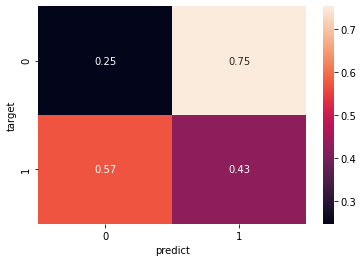

In [153]:
anomaly_cols = [col for col in res_test.columns if re.match(r'^anomaly_f\d+$', col)]
#anomaly_cols = ['anomaly_f29']
res = res_test[anomaly_cols + ['target']].copy()
res.loc[:, anomaly_cols] = res[anomaly_cols].replace({-1: 1})
res.loc[:, ['predict']] = res[anomaly_cols].max(axis=1)

sns.heatmap(confusion_matrix(res['target'], res['predict'], normalize='true'), annot=True)
plt.xlabel('predict')
plt.ylabel('target')

In [144]:
res

,anomaly_f29,target,predict
0,1,1,1
1,0,0,0
2,0,0,0
3,0,0,0
4,0,0,0
...,...,...,...
37334,0,0,0
37335,0,0,0
37336,0,0,0
37337,0,0,0


In [127]:
res_train['target'].sum()

100

In [132]:
res_train['anomaly_f29'].replace({-1: 1}).sum()

24

In [129]:
res_test['target'].sum()

14

In [133]:
res_test['anomaly_f29'].replace({-1: 1}).sum()

5163

In [89]:
# bool(re.match(r'^f\d+$', 'f1'))

In [90]:


df = train_dataset.copy()
df = prophet_fit_predict(df, 'date_col', feature_cols, interval_width=0.99, changepoint_range=0.8)

  0%|          | 0/44 [00:00<?, ?it/s]

In [91]:
anomaly_cols = [col for col in df.columns if re.match(r'^anomaly_f\d+$', col)]
res = df[anomaly_cols + ['target']].copy()
res.loc[:, anomaly_cols] = res[anomaly_cols].replace({-1: 1})
res.loc[:, ['predict']] = res[anomaly_cols].max(axis=1)

In [92]:
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

Text(33.0, 0.5, 'target')

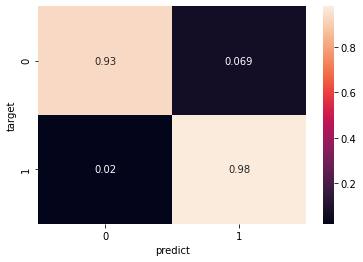

In [93]:
sns.heatmap(confusion_matrix(res['target'], res['predict'], normalize='true'), annot=True)
plt.xlabel('predict')
plt.ylabel('target')

Text(33.0, 0.5, 'target')

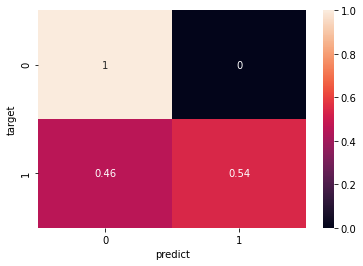

In [62]:
sns.heatmap(confusion_matrix(res['target'], res['predict'], normalize='true'), annot=True)
plt.xlabel('predict')
plt.ylabel('target')

<AxesSubplot:>

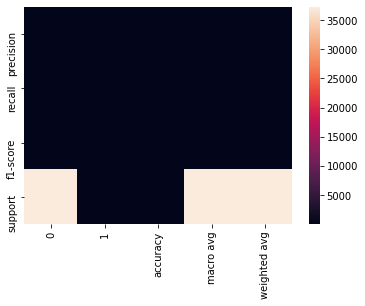

In [53]:
sns.heatmap(pd.DataFrame(classification_report(res['target'], res['anomaly_f31'], output_dict=True)))

In [11]:
forecast = m.predict(df)
forecast['fact'] = df['y'].reset_index(drop = True)

In [12]:
forecasted = forecast[['ds','trend', 'yhat', 'yhat_lower', 'yhat_upper', 'fact']].copy()
forecasted['anomaly'] = 0
forecasted.loc[forecasted['fact'] > forecasted['yhat_upper'], 'anomaly'] = 1
forecasted.loc[forecasted['fact'] < forecasted['yhat_lower'], 'anomaly'] = -1
#anomaly importances
forecasted['importance'] = 0
forecasted.loc[forecasted['anomaly'] ==1, 'importance'] = \
   (forecasted['fact'] - forecasted['yhat_upper'])/forecast['fact']
forecasted.loc[forecasted['anomaly'] ==-1, 'importance'] = \
   (forecasted['yhat_lower'] - forecasted['fact'])/forecast['fact']

In [15]:
forecasted.sort_values('importance')

,ds,trend,yhat,yhat_lower,yhat_upper,fact,anomaly,importance
0,2021-03-24 13:30:00,582.197187,582.197187,532.747788,628.381568,558.600,0,0.000000
24853,2021-12-15 05:00:00,577.724730,577.724730,530.722017,624.460576,574.760,0,0.000000
24854,2021-12-15 05:10:00,577.723704,577.723704,533.442563,623.431827,575.270,0,0.000000
24855,2021-12-15 05:20:00,577.722678,577.722678,527.244620,624.522105,575.660,0,0.000000
24856,2021-12-15 05:30:00,577.721651,577.721651,532.575819,621.781636,574.880,0,0.000000
...,...,...,...,...,...,...,...,...
27082,2021-12-30 16:30:00,558.505170,558.505170,512.290726,607.842267,78.739,-1,5.506188
27084,2021-12-30 16:50:00,558.486106,558.486106,514.179185,603.537558,78.882,-1,5.518334
27081,2021-12-30 16:20:00,558.514702,558.514702,513.378488,605.941843,78.744,-1,5.519589
27089,2021-12-30 17:40:00,558.438445,558.438445,514.650647,608.516899,78.884,-1,5.524145


In [36]:
train_dataset[['f31', 'target']].loc[forecasted['anomaly'].index, 'tt'] = forecasted['anomaly']

In [16]:
res = pd.merge(forecasted, pd.merge(forecasted, train_dataset[['f31', 'target']], left_index=True, right_index=True), left_index=True, right_index=True)

In [32]:
res.sort_values('importance', ascending=False).head(40)

,ds,trend,yhat,yhat_lower,yhat_upper,fact,anomaly,importance,f31,target
27086,2021-12-30 17:10:00,558.467041,558.467041,518.669497,604.766166,78.785,-1,5.583353,78.785,1
27089,2021-12-30 17:40:00,558.438445,558.438445,514.650647,608.516899,78.884,-1,5.524145,78.884,1
27081,2021-12-30 16:20:00,558.514702,558.514702,513.378488,605.941843,78.744,-1,5.519589,78.744,1
27084,2021-12-30 16:50:00,558.486106,558.486106,514.179185,603.537558,78.882,-1,5.518334,78.882,1
27082,2021-12-30 16:30:00,558.505170,558.505170,512.290726,607.842267,78.739,-1,5.506188,78.739,1
27085,2021-12-30 17:00:00,558.476573,558.476573,511.654446,605.913629,78.676,-1,5.503310,78.676,1
27087,2021-12-30 17:20:00,558.457509,558.457509,511.464184,602.963938,78.806,-1,5.490168,78.806,1
27088,2021-12-30 17:30:00,558.447977,558.447977,512.034847,604.150100,78.928,-1,5.487366,78.928,1
27080,2021-12-30 16:10:00,558.524234,558.524234,510.057935,605.089460,78.764,-1,5.475775,78.764,1
27083,2021-12-30 16:40:00,558.495638,558.495638,508.675726,604.535460,78.670,-1,5.465943,78.670,1
